# 1 - KDE

## 1.1 - Implementing KDE

In [107]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

class KernelDensityEstimation:
    def __init__(self, kernel='gaussian'):
        self.kernel = kernel
        self.bandwidth = None
        self.data = None

    def fit(self, data):
        self.data = data
        if self.kernel == 'gaussian':
            self.bandwidth = self._select_bandwidth(data, self._gaussian_kernel)
        elif self.kernel == 'box':
            self.bandwidth = self._select_bandwidth(data, self._box_kernel)
        elif self.kernel == 'triangular':
            self.bandwidth = self._select_bandwidth(data, self._triangular_kernel)

    def _gaussian_kernel(self, x, h):
        return np.exp(-0.5 * ((x / h) ** 2)) / np.sqrt(2 * np.pi)

    def _box_kernel(self, x, h):
        return 0.5 * (np.abs(x / h) <= 1) / h

    def _triangular_kernel(self, x, h):
        return (1 - np.abs(x / h)) * (np.abs(x / h) <= 1) / h

    def _select_bandwidth(self, data, kernel_func):
        n = len(data)
        bandwidths = np.linspace(0.1, 1.0, 100)
        best_bandwidth = None
        max_log_likelihood = float('-inf')
        # print("Selecting bandwidth...")
        for h in bandwidths:
            log_likelihood = 0.0
            for i in range(n):
                xi = data[i]
                data_except_xi = np.delete(data, i, axis=0)
                kernel_values = kernel_func(xi - data_except_xi, h)
                sum_kernel_values = np.sum(kernel_values)
        
                # Avoid taking logarithm of zero
                if sum_kernel_values == 0:
                    continue  # Skip this iteration if sum is zero
                
                log_likelihood += np.log(sum_kernel_values / (n - 1))
            
            log_likelihood /= n

            # print("Bandwidth: {}, Log-likelihood: {}".format(h, log_likelihood))
            if log_likelihood > max_log_likelihood:
                max_log_likelihood = log_likelihood
                best_bandwidth = h
        # print("Bandwidth selected: {}".format(best_bandwidth))
        return best_bandwidth

    def evaluate_density(self, x):
        if self.bandwidth is None or self.data is None:
            raise ValueError("Fit the model before evaluating density.")

        kernel_func = self._gaussian_kernel if self.kernel == 'gaussian' else \
                      self._box_kernel if self.kernel == 'box' else \
                      self._triangular_kernel if self.kernel == 'triangular' else None

        n = len(self.data)
        density = np.zeros_like(x)
        for i in range(len(x)):
            kernel_values = kernel_func(x[i] - self.data, self.bandwidth)
            density[i] = np.sum(kernel_values) / (n * self.bandwidth)

        return density
    
    def visualize(self):
        if self.bandwidth is None or self.data is None:
            raise ValueError("Fit the model before visualization.")

        if self.data.ndim == 1:
            # 1D visualization
            x_values = np.linspace(min(self.data), max(self.data), 1000)
            density = self.evaluate_density(x_values)

            plt.figure(figsize=(8, 6))
            plt.plot(x_values, density, label='KDE')
            plt.hist(self.data, density=True, alpha=0.5, bins=20, label='Data Histogram')
            plt.xlabel('Data')
            plt.ylabel('Density')
            plt.title('Kernel Density Estimation for 1D Data with {} Kernel'.format(self.kernel))
            plt.legend()
            plt.show()
        elif self.data.ndim == 2:
            # 2D visualization with 3D graph
            kde = gaussian_kde(self.data.T, bw_method=self.bandwidth)

            x, y = self.data[:, 0], self.data[:, 1]
            xmin, xmax = np.min(x), np.max(x)
            ymin, ymax = np.min(y), np.max(y)

            fig = plt.figure(figsize=(10, 8))
            ax = fig.add_subplot(111, projection='3d')

            # Create a grid of points
            xx, yy = np.meshgrid(np.linspace(xmin, xmax, 100), np.linspace(ymin, ymax, 100))
            positions = np.vstack([xx.ravel(), yy.ravel()])
            zz = np.reshape(kde(positions).T, xx.shape)

            ax.plot_surface(xx, yy, zz, cmap='viridis', edgecolor='none')
            ax.set_xlabel('X')
            ax.set_ylabel('Y')
            ax.set_zlabel('Density')
            ax.set_title('Kernel Density Estimation for 2D Data with {} Kernel'.format(self.kernel))
            plt.show()


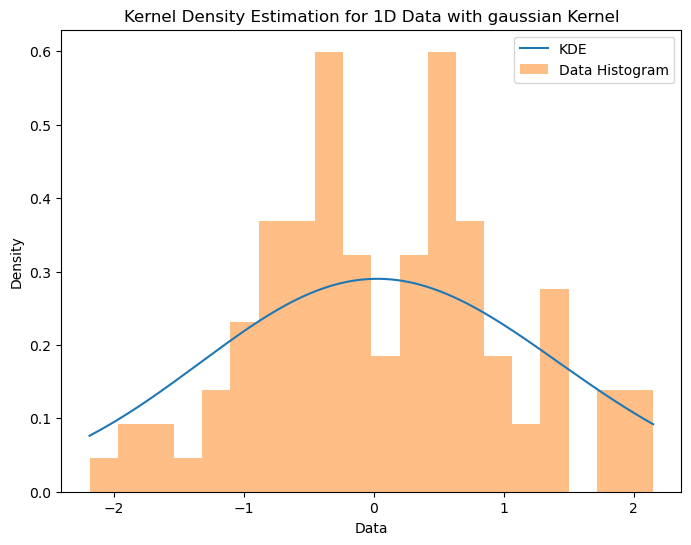

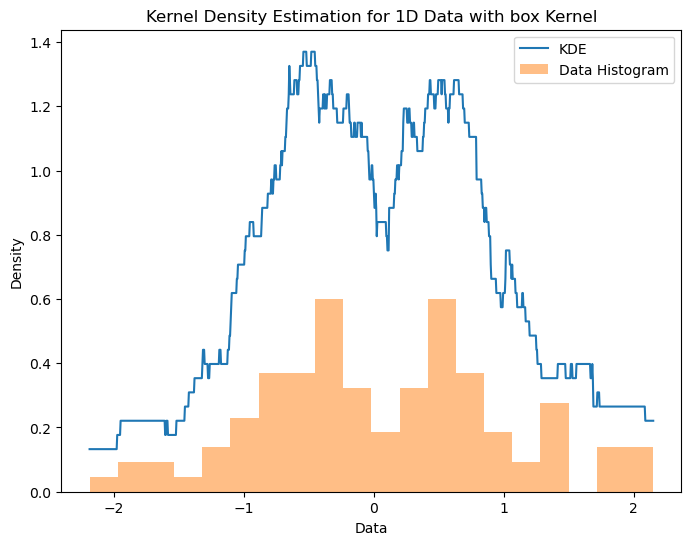

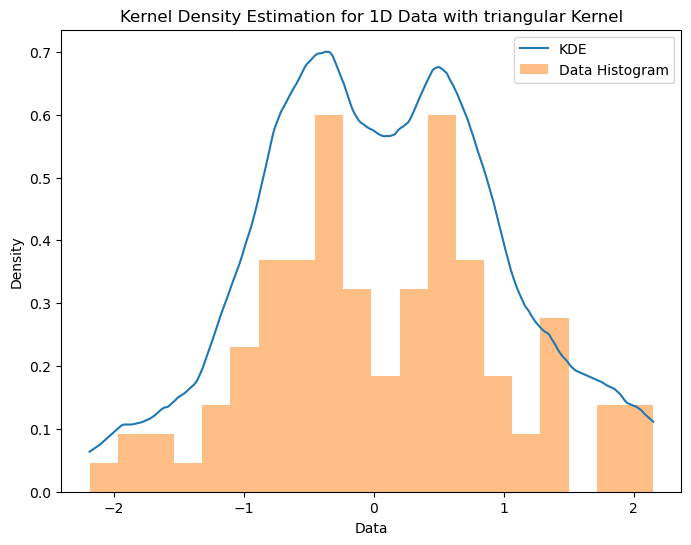

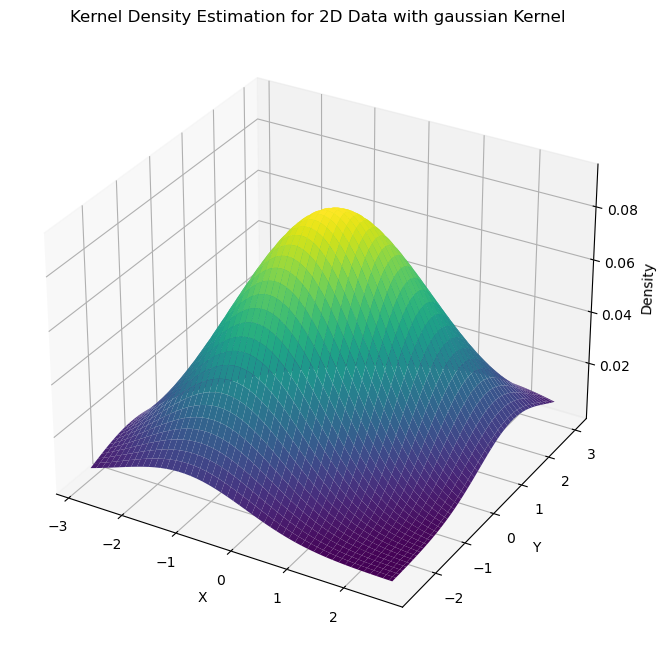

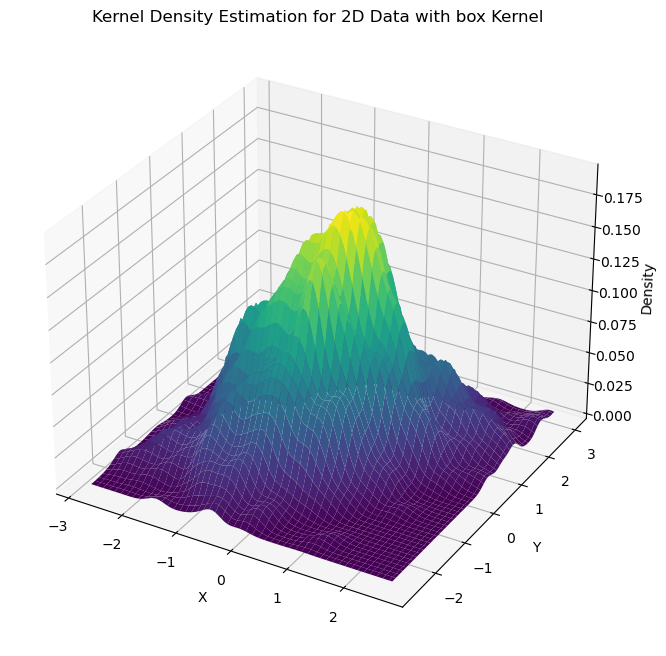

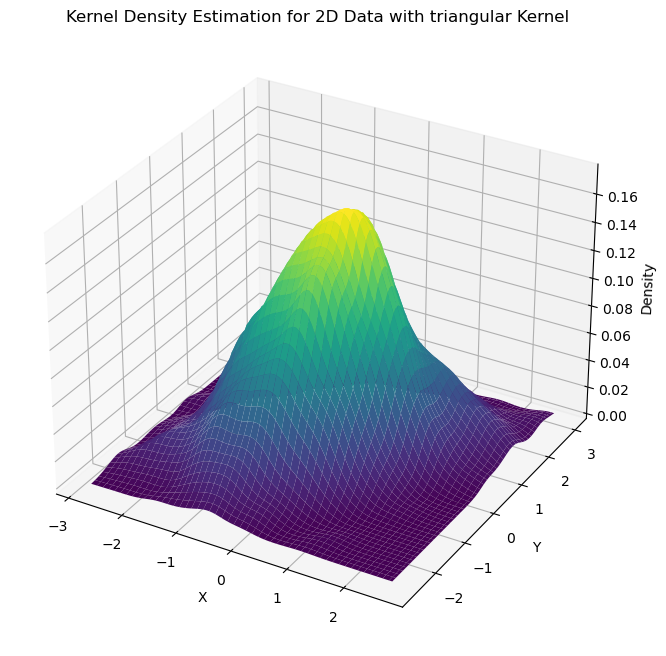

In [47]:
# 1D Data Example
np.random.seed(13)
data_1d = np.random.normal(0, 1, 100)

# Initialize KDE with all kernels
kde = KernelDensityEstimation(kernel='gaussian')
kde.fit(data_1d)
kde.visualize()

kde = KernelDensityEstimation(kernel='box')
kde.fit(data_1d)
kde.visualize()

kde = KernelDensityEstimation(kernel='triangular')
kde.fit(data_1d)
kde.visualize()

# 2D Data Example
np.random.seed(13)
mean = [0, 0]
cov = [[1, 0.5], [0.5, 1]]
data_2d = np.random.multivariate_normal(mean, cov, 1000)

# Initialize KDE with all kernels
kde = KernelDensityEstimation(kernel='gaussian')
kde.fit(data_2d)
kde.visualize()

kde = KernelDensityEstimation(kernel='box')
kde.fit(data_2d)
kde.visualize()

kde = KernelDensityEstimation(kernel='triangular')
kde.fit(data_2d)
kde.visualize()



In [6]:
# Example data generation for density estimation
np.random.seed(13)
data_1d = np.random.normal(0, 1, 100)  # 1D data
data_2d = np.random.multivariate_normal([0, 0], [[1, 0.5], [0.5, 1]], 1000)  # 2D data
data_3d = np.random.multivariate_normal([0, 0, 0], [[1, 0.5, 0.3], [0.5, 1, 0.2], [0.3, 0.2, 1]], 1000)  # 3D data

# Initialize KDE with Gaussian kernel
kde_1d = KernelDensityEstimation(kernel='gaussian')
kde_2d = KernelDensityEstimation(kernel='gaussian')
kde_3d = KernelDensityEstimation(kernel='gaussian')

# Fit data
kde_1d.fit(data_1d)
kde_2d.fit(data_2d)
kde_3d.fit(data_3d)

In [7]:
# Calculate density at specific points
point_1d = np.array([0.5])  # Point in 1D
point_2d = np.array([0.5, 0.5])  # Point in 2D
point_3d = np.array([0.5, 0.5, 0.5])  # Point in 3D

density_at_point_1d = kde_1d.evaluate_density(point_1d)[0]
density_at_point_2d = kde_2d.evaluate_density(point_2d)[0]
density_at_point_3d = kde_3d.evaluate_density(point_3d)[0]

print(f"Density at point {point_1d} in 1D data: {density_at_point_1d}")
print(f"Density at point {point_2d} in 2D data: {density_at_point_2d}")
print(f"Density at point {point_3d} in 3D data: {density_at_point_3d}")

Density at point [0.5] in 1D data: 0.26997009130213157
Density at point [0.5 0.5] in 2D data: 0.5305228400056713
Density at point [0.5 0.5 0.5] in 3D data: 0.8008495114331897


## 1.2 - Bounding Box

In [132]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings

warnings.filterwarnings("ignore")
np.set_printoptions(threshold=np.inf)
pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)

In [133]:
df = pd.read_csv("OneDrive_2023-12-03/SMAI - AQ2/CSV/TLBR_68.csv")
df.drop(["Unnamed: 0"], axis=1, inplace=True)
euclidean = df.copy(deep=True)

In [135]:
#chatGPT
pairwise_tuples_left = list(
    zip(
        euclidean["Top-Left"].str.split(",").str[0].apply(lambda x: int(x[1:])),
        (
            euclidean["Top-Left"].str.split(",").str[1].apply(lambda x: float(x[:-1]))
            + euclidean["Bottom-Right"]
            .str.split(",")
            .str[1]
            .apply(lambda x: int(x[:-1]))
        )
        / 2,
    )
)

pairwise_tuples_right = list(
    zip(
        euclidean["Bottom-Right"].str.split(",").str[0].apply(lambda x: int(x[1:])),
        (
            euclidean["Top-Left"].str.split(",").str[1].apply(lambda x: float(x[:-1]))
            + euclidean["Bottom-Right"]
            .str.split(",")
            .str[1]
            .apply(lambda x: int(x[:-1]))
        )
        / 2,
    )
)

pairwise_tuples_top = list(
    zip(
        (
            euclidean["Top-Left"].str.split(",").str[0].apply(lambda x: float(x[1:]))
            + euclidean["Bottom-Right"]
            .str.split(",")
            .str[0]
            .apply(lambda x: int(x[1:]))
        )
        / 2,
        euclidean["Top-Left"].str.split(",").str[1].apply(lambda x: int(x[:-1])),
    )
)

pairwise_tuples_bottom = list(
    zip(
        (
            euclidean["Top-Left"].str.split(",").str[0].apply(lambda x: float(x[1:]))
            + euclidean["Bottom-Right"]
            .str.split(",")
            .str[0]
            .apply(lambda x: int(x[1:]))
        )
        / 2,
        euclidean["Bottom-Right"].str.split(",").str[1].apply(lambda x: int(x[:-1])),
    )
)


In [136]:
import cv2
img = cv2.imread("OneDrive_2023-12-03/SMAI - AQ2/images/68.jpg")

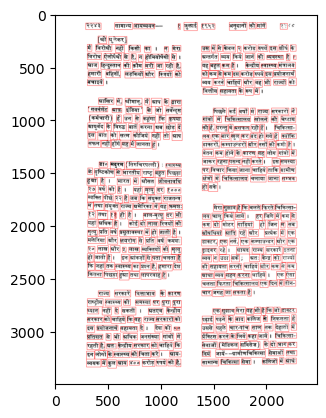

In [137]:
def bounding_boxes(img):
    img_2 = img.copy()
    for index, rows in df.iterrows():
        top_left = (
            int(rows["Top-Left"].split(",")[0][1:]),
            int(rows["Top-Left"].split(",")[1][:-1]),
        )
        bottom_right = (
            int(rows["Bottom-Right"].split(",")[0][1:]),
            int(rows["Bottom-Right"].split(",")[1][:-1]),
        )
        cv2.rectangle(img_2, top_left, bottom_right, (255, 0, 0), 2)

    plt.imshow(img_2)

bounding_boxes(img)

In [138]:
#chatGPT
def make_connections(image):
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    image_with_boxes = image_rgb.copy()

    for index, row in euclidean.iterrows():
        left = int(row["Left"][0])
        right = int(row["Right"][0])
        top = int(row["Top"][1])
        bottom = int(row["Bottom"][1])
        box_id = int(row["Id"])

        width = right - left
        height = bottom - top

        top_left = (left, top)
        bottom_right = (right, bottom)

        cv2.rectangle(image_with_boxes, top_left, bottom_right, (255, 0, 0), 2)

        label_position = (left, top - 10)
        cv2.putText(
            image_with_boxes,
            str(box_id),
            label_position,
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            (0, 0, 255),
            1,
        )

        top_adjacent_id = int(row["Top_Box"][1])
        bottom_adjacent_id = int(row["Bottom_Box"][1])
        left_adjacent_id = int(row["Left_Box"][1])
        right_adjacent_id = int(row["Right_Box"][1])

        if top_adjacent_id != 0:
            top_adjacent_row = euclidean[euclidean["Id"] == top_adjacent_id].iloc[0]
            top_adjacent_center = int(top_adjacent_row["Bottom"][0]), int(
                top_adjacent_row["Bottom"][1]
            )
            cv2.line(
                image_with_boxes,
                (int(left) + width // 2, int(top)),
                top_adjacent_center,
                (0, 255, 0),
                2,
            )

        if bottom_adjacent_id != 0:
            bottom_adjacent_row = euclidean[euclidean["Id"] == bottom_adjacent_id].iloc[
                0
            ]
            bottom_adjacent_center = int(bottom_adjacent_row["Top"][0]), int(
                bottom_adjacent_row["Top"][1]
            )
            cv2.line(
                image_with_boxes,
                (int(left) + width // 2, int(bottom)),
                (int(bottom_adjacent_center[0]), int(bottom_adjacent_center[1])),
                (0, 255, 0),
                2,
            )

        if left_adjacent_id != 0:
            left_adjacent_row = euclidean[euclidean["Id"] == left_adjacent_id].iloc[0]
            left_adjacent_center = int(left_adjacent_row["Right"][0]), int(
                left_adjacent_row["Right"][1]
            )
            cv2.line(
                image_with_boxes,
                (int(left), int(top) + height // 2),
                (int(left_adjacent_center[0]), int(left_adjacent_center[1])),
                (0, 255, 0),
                2,
            )

        if right_adjacent_id != 0:
            right_adjacent_row = euclidean[euclidean["Id"] == right_adjacent_id].iloc[0]
            right_adjacent_center = int(right_adjacent_row["Left"][0]), int(
                right_adjacent_row["Left"][1]
            )
            cv2.line(
                image_with_boxes,
                (int(right), int(top) + height // 2),
                (int(right_adjacent_center[0]), int(right_adjacent_center[1])),
                (0, 255, 0),
                2,
            )

    return image_with_boxes

In [139]:
euclidean_new = pd.DataFrame()
euclidean_new["Id"] = euclidean["Id"]
euclidean_new["Left-x"] = euclidean["Left"].apply(lambda x: x[0])
euclidean_new["Left-y"] = euclidean["Left"].apply(lambda x: x[1])
euclidean_new["Top-x"] = euclidean["Top"].apply(lambda x: x[0])
euclidean_new["Top-y"] = euclidean["Top"].apply(lambda x: x[1])
euclidean_new["Right-x"] = euclidean["Right"].apply(lambda x: x[0])
euclidean_new["Right-y"] = euclidean["Right"].apply(lambda x: x[1])
euclidean_new["Bottom-x"] = euclidean["Bottom"].apply(lambda x: x[0])
euclidean_new["Bottom-y"] = euclidean["Bottom"].apply(lambda x: x[1])

euclidean_new["Centre-x"] = (euclidean_new["Left-x"] + euclidean_new["Right-x"]) / 2
euclidean_new["Centre-y"] = (euclidean_new["Top-y"] + euclidean_new["Bottom-y"]) / 2

In [140]:
def dis(x1, y1, x2, y2):
    return np.sqrt((x1 - x2) ** 2 + (y1 - y2) ** 2)

In [141]:
euclidean_new["Top_Box"] = None
euclidean_new["Bottom_Box"] = None
euclidean_new["Left_Box"] = None
euclidean_new["Right_Box"] = None


#chatGPT
for index, row in euclidean_new.iterrows():
    if row["Top-y"] >= np.min(euclidean_new["Bottom-y"]):
        val = row["Top-y"]
        temp = euclidean_new[
            (euclidean_new["Bottom-y"] < val) & (row["Id"] != euclidean_new["Id"])
        ]
        temp["distance"] = temp.apply(
            lambda x: dis(
                x["Centre-x"], x["Centre-y"], row["Centre-x"], row["Centre-y"]
            ),
            axis=1,
        )
        id = temp.loc[temp["distance"].idxmin(), "Id"]
        distance = temp.loc[temp["distance"].idxmin(), "distance"]
        euclidean_new.at[index, "Top_Box"] = [distance, id]
    else:
        euclidean_new.at[index, "Top_Box"] = [-1, 0]

for index, row in euclidean_new.iterrows():
    if row["Bottom-y"] <= np.max(euclidean_new["Top-y"]):
        val = row["Bottom-y"]
        temp = euclidean_new[
            (euclidean_new["Top-y"] > val) & (row["Id"] != euclidean_new["Id"])
        ]
        temp["distance"] = temp.apply(
            lambda x: dis(
                x["Centre-x"], x["Centre-y"], row["Centre-x"], row["Centre-y"]
            ),
            axis=1,
        )
        id = temp.loc[temp["distance"].idxmin(), "Id"]
        distance = temp.loc[temp["distance"].idxmin(), "distance"]
        euclidean_new.at[index, "Bottom_Box"] = [distance, id]
    else:
        euclidean_new.at[index, "Bottom_Box"] = [-1, 0]

for index, row in euclidean_new.iterrows():
    if row["Left-x"] >= np.min(euclidean_new["Right-x"]):
        val = row["Left-x"]
        temp = euclidean_new[
            (euclidean_new["Right-x"] < val) & (row["Id"] != euclidean_new["Id"])
        ]
        temp["distance"] = temp.apply(
            lambda x: dis(
                x["Centre-x"], x["Centre-y"], row["Centre-x"], row["Centre-y"]
            ),
            axis=1,
        )
        id = temp.loc[temp["distance"].idxmin(), "Id"]
        distance = temp.loc[temp["distance"].idxmin(), "distance"]
        euclidean_new.at[index, "Left_Box"] = [distance, id]
    else:
        euclidean_new.at[index, "Left_Box"] = [-1, 0]

for index, row in euclidean_new.iterrows():
    if row["Right-x"] <= np.max(euclidean_new["Left-x"]):
        val = row["Right-x"]
        temp = euclidean_new[
            (euclidean_new["Left-x"] > val) & (row["Id"] != euclidean_new["Id"])
        ]
        temp["distance"] = temp.apply(
            lambda x: dis(
                x["Centre-x"], x["Centre-y"], row["Centre-x"], row["Centre-y"]
            ),
            axis=1,
        )
        id = temp.loc[temp["distance"].idxmin(), "Id"]
        distance = temp.loc[temp["distance"].idxmin(), "distance"]
        euclidean_new.at[index, "Right_Box"] = [distance, id]
    else:
        euclidean_new.at[index, "Right_Box"] = [-1, 0]
euclidean[["Top_Box", "Bottom_Box", "Left_Box", "Right_Box"]] = euclidean_new[
    ["Top_Box", "Bottom_Box", "Left_Box", "Right_Box"]
]

In [142]:
top = pd.DataFrame(euclidean_new["Top_Box"])
bottom = pd.DataFrame(euclidean_new["Bottom_Box"])
left = pd.DataFrame(euclidean_new["Left_Box"])
right = pd.DataFrame(euclidean_new["Right_Box"])

In [144]:
#chatGPT
def set_threshold(data):
    column = data.columns[0]
    temp = data[column].apply(lambda x: x[0])
    np_data = np.array(temp)
    np_data = np.squeeze(np_data)
    kde = KernelDensityEstimation(kernel="gaussian")
    kde.fit(np_data)
    results = np.zeros((len(np_data)))
    for index, row in enumerate(np_data):
        results[index] = kde.evaluate_density([row])
    mean = results.mean()
    for index, row in enumerate(np_data):
        if kde.evaluate_density([row]) < mean:
            data.iloc[index, 0] = [-1, 0]
    euclidean[column] = data

set_threshold(top)
set_threshold(bottom)
set_threshold(left)
set_threshold(right)

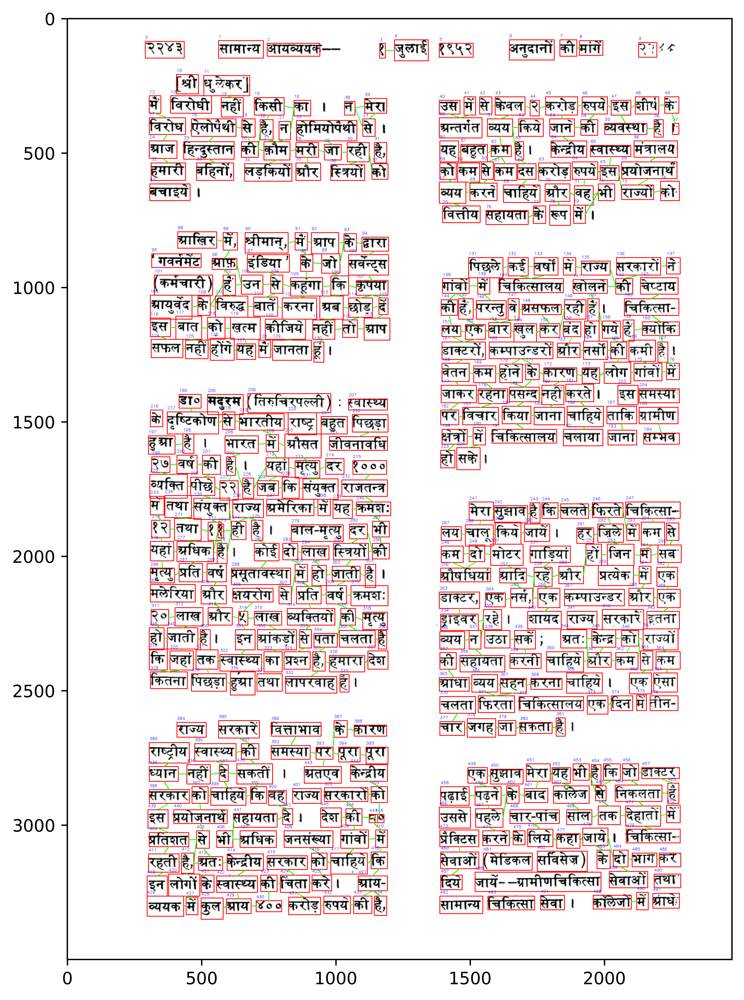

In [145]:
plt.figure(figsize=(10,10),dpi=1000)
plt.imshow(make_connections(img))

#### GMM

In [146]:
pairwise_tuples_left = list(
    zip(
        euclidean["Top-Left"].str.split(",").str[0].apply(lambda x: int(x[1:])),
        (
            euclidean["Top-Left"].str.split(",").str[1].apply(lambda x: float(x[:-1]))
            + euclidean["Bottom-Right"]
            .str.split(",")
            .str[1]
            .apply(lambda x: int(x[:-1]))
        )
        / 2,
    )
)

pairwise_tuples_right = list(
    zip(
        euclidean["Bottom-Right"].str.split(",").str[0].apply(lambda x: int(x[1:])),
        (
            euclidean["Top-Left"].str.split(",").str[1].apply(lambda x: float(x[:-1]))
            + euclidean["Bottom-Right"]
            .str.split(",")
            .str[1]
            .apply(lambda x: int(x[:-1]))
        )
        / 2,
    )
)

pairwise_tuples_top = list(
    zip(
        (
            euclidean["Top-Left"].str.split(",").str[0].apply(lambda x: float(x[1:]))
            + euclidean["Bottom-Right"]
            .str.split(",")
            .str[0]
            .apply(lambda x: int(x[1:]))
        )
        / 2,
        euclidean["Top-Left"].str.split(",").str[1].apply(lambda x: int(x[:-1])),
    )
)

pairwise_tuples_bottom = list(
    zip(
        (
            euclidean["Top-Left"].str.split(",").str[0].apply(lambda x: float(x[1:]))
            + euclidean["Bottom-Right"]
            .str.split(",")
            .str[0]
            .apply(lambda x: int(x[1:]))
        )
        / 2,
        euclidean["Bottom-Right"].str.split(",").str[1].apply(lambda x: int(x[:-1])),
    )
)

In [147]:
euclidean_new = pd.DataFrame()
euclidean_new["Id"] = euclidean["Id"]
euclidean_new["Left-x"] = euclidean["Left"].apply(lambda x: x[0])
euclidean_new["Left-y"] = euclidean["Left"].apply(lambda x: x[1])
euclidean_new["Top-x"] = euclidean["Top"].apply(lambda x: x[0])
euclidean_new["Top-y"] = euclidean["Top"].apply(lambda x: x[1])
euclidean_new["Right-x"] = euclidean["Right"].apply(lambda x: x[0])
euclidean_new["Right-y"] = euclidean["Right"].apply(lambda x: x[1])
euclidean_new["Bottom-x"] = euclidean["Bottom"].apply(lambda x: x[0])
euclidean_new["Bottom-y"] = euclidean["Bottom"].apply(lambda x: x[1])

euclidean_new["Centre-x"] = (euclidean_new["Left-x"] + euclidean_new["Right-x"]) / 2
euclidean_new["Centre-y"] = (euclidean_new["Top-y"] + euclidean_new["Bottom-y"]) / 2

In [149]:
euclidean_new["Top_Box"] = None
euclidean_new["Bottom_Box"] = None
euclidean_new["Left_Box"] = None
euclidean_new["Right_Box"] = None

#chatGPT
for index, row in euclidean_new.iterrows():
    if row["Top-y"] >= np.min(euclidean_new["Bottom-y"]):
        val = row["Top-y"]
        temp = euclidean_new[
            (euclidean_new["Bottom-y"] < val) & (row["Id"] != euclidean_new["Id"])
        ]
        temp["distance"] = temp.apply(
            lambda x: dis(
                x["Centre-x"], x["Centre-y"], row["Centre-x"], row["Centre-y"]
            ),
            axis=1,
        )
        id = temp.loc[temp["distance"].idxmin(), "Id"]
        distance = temp.loc[temp["distance"].idxmin(), "distance"]
        euclidean_new.at[index, "Top_Box"] = [distance, id]
    else:
        euclidean_new.at[index, "Top_Box"] = [-1, 0]

for index, row in euclidean_new.iterrows():
    if row["Bottom-y"] <= np.max(euclidean_new["Top-y"]):
        val = row["Bottom-y"]
        temp = euclidean_new[
            (euclidean_new["Top-y"] > val) & (row["Id"] != euclidean_new["Id"])
        ]
        temp["distance"] = temp.apply(
            lambda x: dis(
                x["Centre-x"], x["Centre-y"], row["Centre-x"], row["Centre-y"]
            ),
            axis=1,
        )
        id = temp.loc[temp["distance"].idxmin(), "Id"]
        distance = temp.loc[temp["distance"].idxmin(), "distance"]
        euclidean_new.at[index, "Bottom_Box"] = [distance, id]
    else:
        euclidean_new.at[index, "Bottom_Box"] = [-1, 0]

for index, row in euclidean_new.iterrows():
    if row["Left-x"] >= np.min(euclidean_new["Right-x"]):
        val = row["Left-x"]
        temp = euclidean_new[
            (euclidean_new["Right-x"] < val) & (row["Id"] != euclidean_new["Id"])
        ]
        temp["distance"] = temp.apply(
            lambda x: dis(
                x["Centre-x"], x["Centre-y"], row["Centre-x"], row["Centre-y"]
            ),
            axis=1,
        )
        id = temp.loc[temp["distance"].idxmin(), "Id"]
        distance = temp.loc[temp["distance"].idxmin(), "distance"]
        euclidean_new.at[index, "Left_Box"] = [distance, id]
    else:
        euclidean_new.at[index, "Left_Box"] = [-1, 0]

for index, row in euclidean_new.iterrows():
    if row["Right-x"] <= np.max(euclidean_new["Left-x"]):
        val = row["Right-x"]
        temp = euclidean_new[
            (euclidean_new["Left-x"] > val) & (row["Id"] != euclidean_new["Id"])
        ]
        temp["distance"] = temp.apply(
            lambda x: dis(
                x["Centre-x"], x["Centre-y"], row["Centre-x"], row["Centre-y"]
            ),
            axis=1,
        )
        id = temp.loc[temp["distance"].idxmin(), "Id"]
        distance = temp.loc[temp["distance"].idxmin(), "distance"]
        euclidean_new.at[index, "Right_Box"] = [distance, id]
    else:
        euclidean_new.at[index, "Right_Box"] = [-1, 0]
euclidean[["Top_Box", "Bottom_Box", "Left_Box", "Right_Box"]] = euclidean_new[
    ["Top_Box", "Bottom_Box", "Left_Box", "Right_Box"]
]

In [150]:
top = pd.DataFrame(euclidean_new["Top_Box"])
bottom = pd.DataFrame(euclidean_new["Bottom_Box"])
left = pd.DataFrame(euclidean_new["Left_Box"])
right = pd.DataFrame(euclidean_new["Right_Box"])

In [152]:
# now use set_threshold function to set threshold for GMM 
from sklearn.mixture import GaussianMixture
def set_threshold(data):
    column = data.columns[0]
    temp = data[column].apply(lambda x: x[0])
    np_data = np.array(temp)
    np_data = np.squeeze(np_data)
    gmm = GaussianMixture(n_components=2)
    gmm.fit(np_data.reshape(-1,1))
    results = np.zeros((len(np_data)))
    for index, row in enumerate(np_data):
        results[index] = gmm.score_samples([[row]])
    mean = results.mean()
    for index, row in enumerate(np_data):
        if gmm.score_samples([[row]]) < mean:
            data.iloc[index, 0] = [-1, 0]
    euclidean[column] = data

set_threshold(top)
set_threshold(bottom)
set_threshold(left)
set_threshold(right)


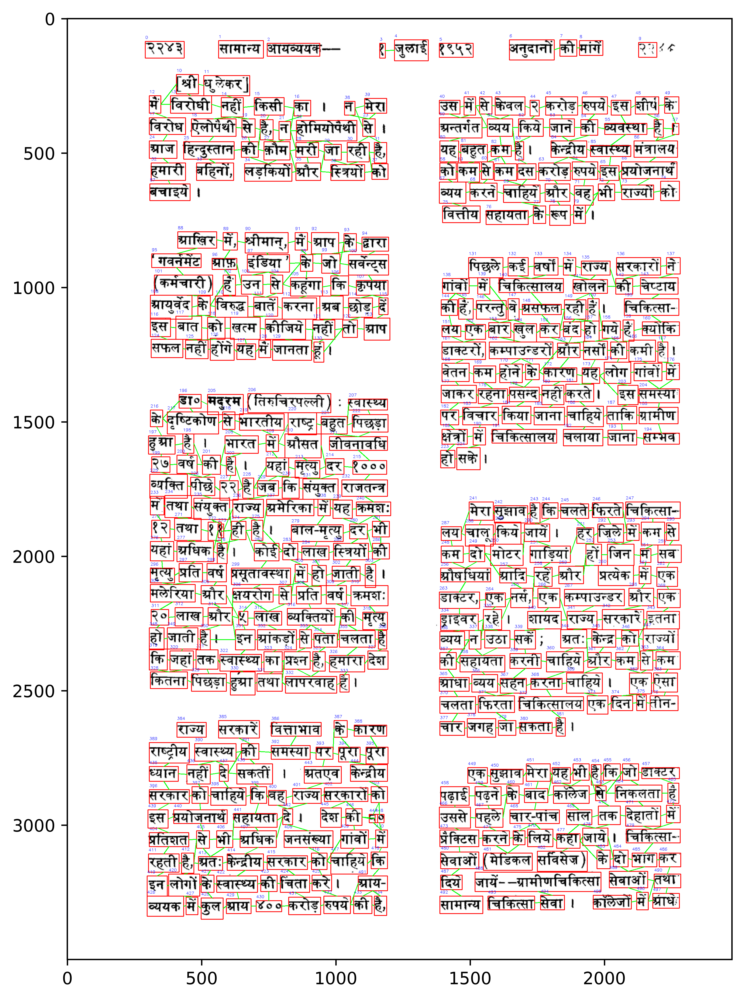

In [153]:
plt.figure(figsize=(10,10),dpi=1000)
plt.imshow(make_connections(img))